# <center>Oil Spill Analysis Using Machine Learning

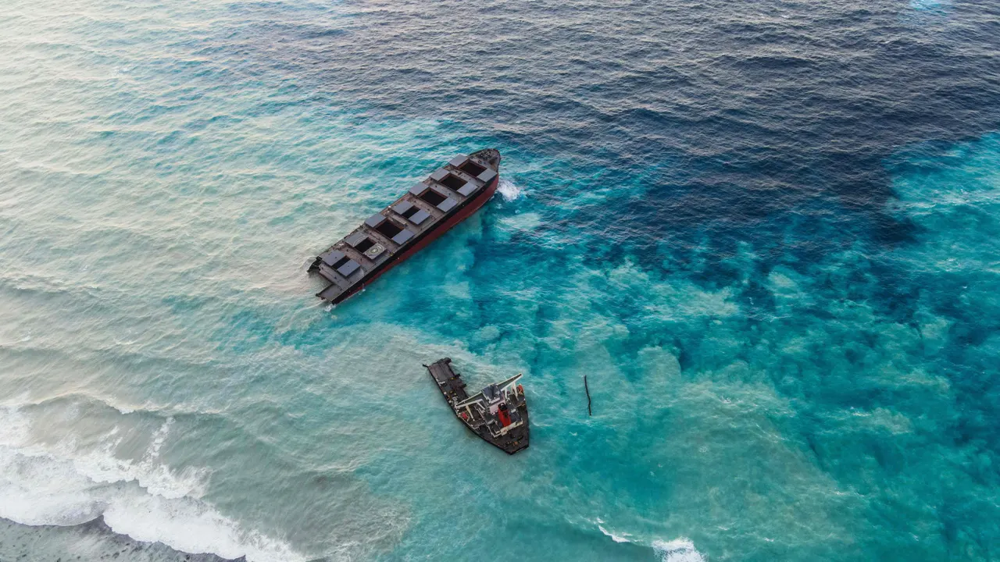

##### Dataset Link
https://www.kaggle.com/datasets/sudhanshu2198/oil-spill-detection

##### Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')
from sklearn import metrics
from sklearn.metrics import accuracy_score,confusion_matrix,precision_score
from sklearn.preprocessing import StandardScaler,LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier

In [2]:
data = pd.read_csv('./oil_spill.csv')
data

,f_1,f_2,f_3,f_4,f_5,f_6,f_7,f_8,f_9,f_10,...,f_41,f_42,f_43,f_44,f_45,f_46,f_47,f_48,f_49,target
0,1,2558,1506.09,456.63,90,6395000,40.88,7.89,29780.0,0.19,...,2850.00,1000.00,763.16,135.46,3.73,0,33243.19,65.74,7.95,1
1,2,22325,79.11,841.03,180,55812500,51.11,1.21,61900.0,0.02,...,5750.00,11500.00,9593.48,1648.80,0.60,0,51572.04,65.73,6.26,0
2,3,115,1449.85,608.43,88,287500,40.42,7.34,3340.0,0.18,...,1400.00,250.00,150.00,45.13,9.33,1,31692.84,65.81,7.84,1
3,4,1201,1562.53,295.65,66,3002500,42.40,7.97,18030.0,0.19,...,6041.52,761.58,453.21,144.97,13.33,1,37696.21,65.67,8.07,1
4,5,312,950.27,440.86,37,780000,41.43,7.03,3350.0,0.17,...,1320.04,710.63,512.54,109.16,2.58,0,29038.17,65.66,7.35,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
932,200,12,92.42,364.42,135,97200,59.42,10.34,884.0,0.17,...,381.84,254.56,84.85,146.97,4.50,0,2593.50,65.85,6.39,0
933,201,11,98.82,248.64,159,89100,59.64,10.18,831.0,0.17,...,284.60,180.00,150.00,51.96,1.90,0,4361.25,65.70,6.53,0
934,202,14,25.14,428.86,24,113400,60.14,17.94,847.0,0.30,...,402.49,180.00,180.00,0.00,2.24,0,2153.05,65.91,6.12,0
935,203,10,96.00,451.30,68,81000,59.90,15.01,831.0,0.25,...,402.49,180.00,90.00,73.48,4.47,0,2421.43,65.97,6.32,0


In [3]:
data.shape

(937, 50)

In [4]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
f_1,937.0,81.588047,6.497673e+01,1.00,31.00,64.00,124.00,352.00
f_2,937.0,332.842049,1.931939e+03,10.00,20.00,65.00,132.00,32389.00
f_3,937.0,698.707086,5.999656e+02,1.92,85.27,704.37,1223.48,1893.08
f_4,937.0,870.992209,5.227993e+02,1.00,444.20,761.28,1260.37,2724.57
f_5,937.0,84.121665,4.536177e+01,0.00,54.00,73.00,117.00,180.00
f_6,937.0,769696.378869,3.831151e+06,70312.00,125000.00,186300.00,330468.00,71315000.00
f_7,937.0,43.242721,1.271840e+01,21.24,33.65,39.97,52.42,82.64
f_8,937.0,9.127887,3.588878e+00,0.83,6.75,8.20,10.76,24.69
f_9,937.0,3940.712914,8.167428e+03,667.00,1371.00,2090.00,3435.00,160740.00
f_10,937.0,0.221003,9.031555e-02,0.02,0.16,0.20,0.26,0.74


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 937 entries, 0 to 936
Data columns (total 50 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   f_1     937 non-null    int64  
 1   f_2     937 non-null    int64  
 2   f_3     937 non-null    float64
 3   f_4     937 non-null    float64
 4   f_5     937 non-null    int64  
 5   f_6     937 non-null    int64  
 6   f_7     937 non-null    float64
 7   f_8     937 non-null    float64
 8   f_9     937 non-null    float64
 9   f_10    937 non-null    float64
 10  f_11    937 non-null    float64
 11  f_12    937 non-null    float64
 12  f_13    937 non-null    float64
 13  f_14    937 non-null    float64
 14  f_15    937 non-null    float64
 15  f_16    937 non-null    float64
 16  f_17    937 non-null    float64
 17  f_18    937 non-null    float64
 18  f_19    937 non-null    float64
 19  f_20    937 non-null    float64
 20  f_21    937 non-null    float64
 21  f_22    937 non-null    float64
 22  f_

In [6]:
data.isnull().mean()*100

f_1       0.0
f_2       0.0
f_3       0.0
f_4       0.0
f_5       0.0
f_6       0.0
f_7       0.0
f_8       0.0
f_9       0.0
f_10      0.0
f_11      0.0
f_12      0.0
f_13      0.0
f_14      0.0
f_15      0.0
f_16      0.0
f_17      0.0
f_18      0.0
f_19      0.0
f_20      0.0
f_21      0.0
f_22      0.0
f_23      0.0
f_24      0.0
f_25      0.0
f_26      0.0
f_27      0.0
f_28      0.0
f_29      0.0
f_30      0.0
f_31      0.0
f_32      0.0
f_33      0.0
f_34      0.0
f_35      0.0
f_36      0.0
f_37      0.0
f_38      0.0
f_39      0.0
f_40      0.0
f_41      0.0
f_42      0.0
f_43      0.0
f_44      0.0
f_45      0.0
f_46      0.0
f_47      0.0
f_48      0.0
f_49      0.0
target    0.0
dtype: float64

In [7]:
data.duplicated().sum()

0

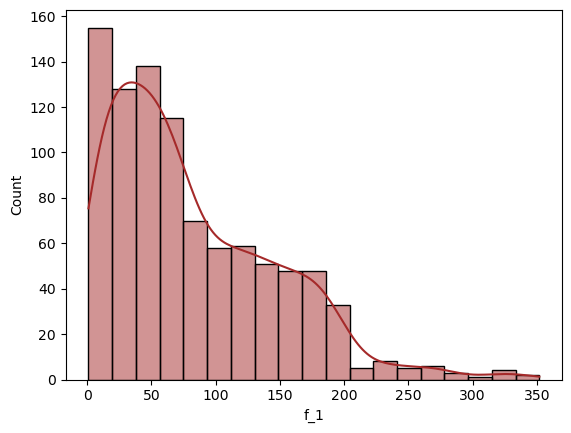

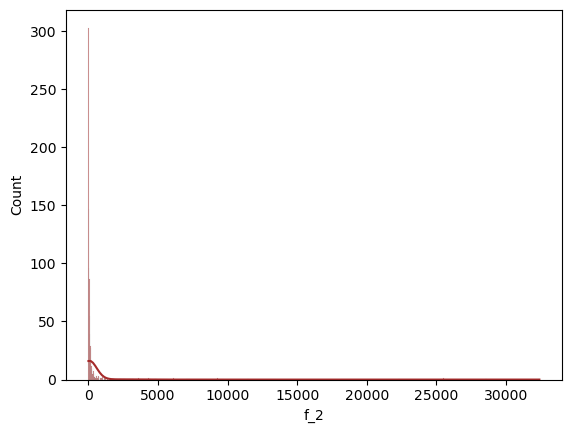

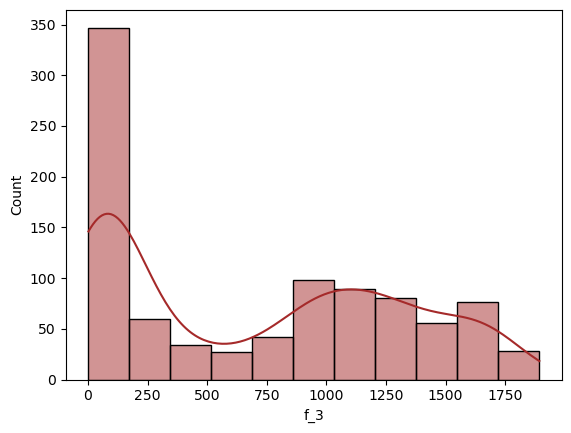

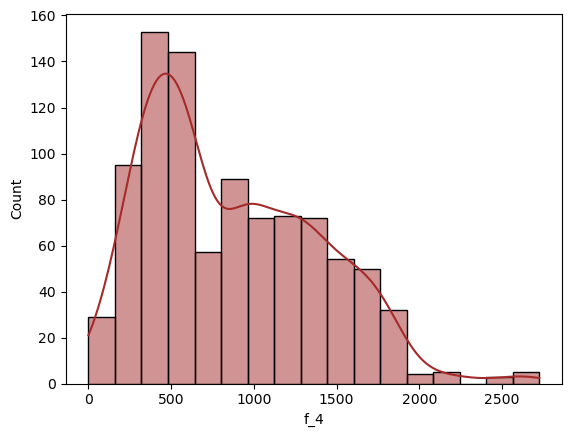

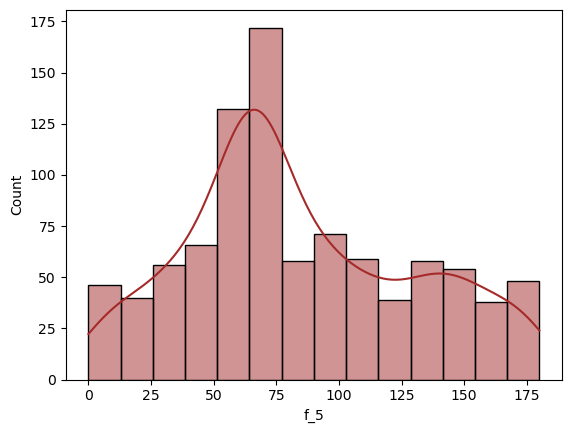

...

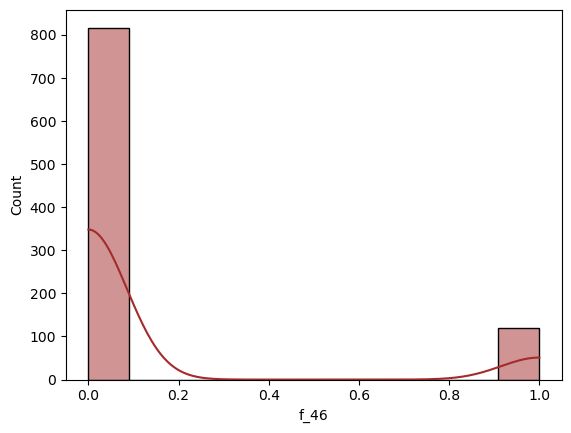

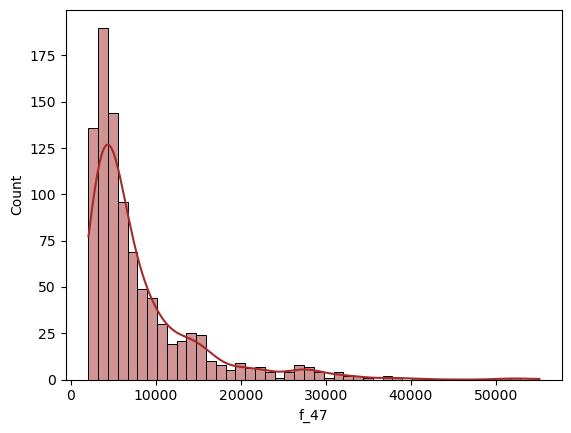

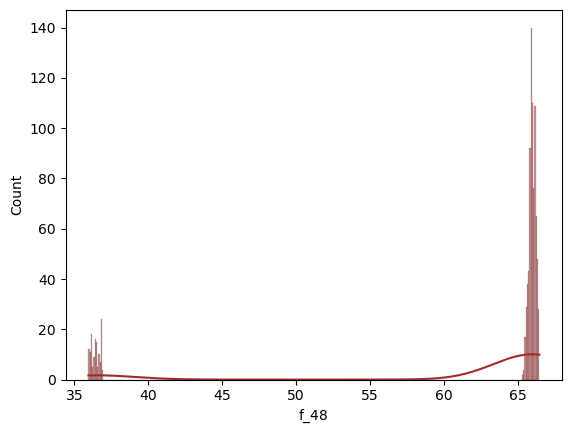

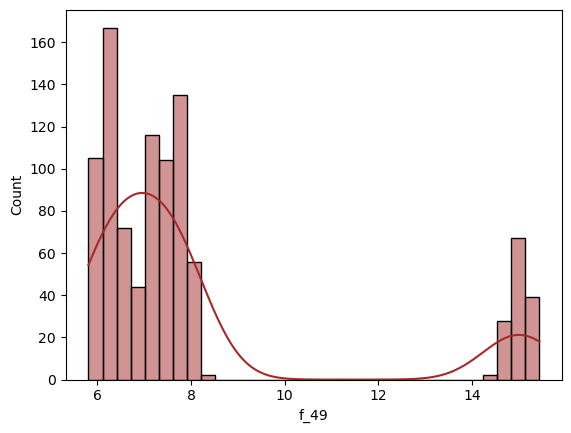

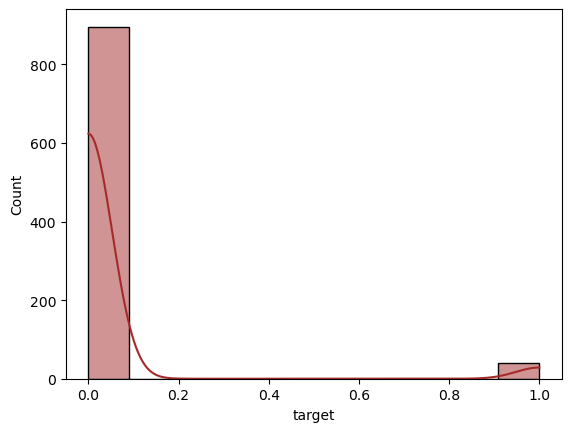

In [8]:
for column in data.columns:
    if data[column].dtype != "object":
        sns.histplot(data, x=data[column], kde=True, color="brown")
        plt.show()

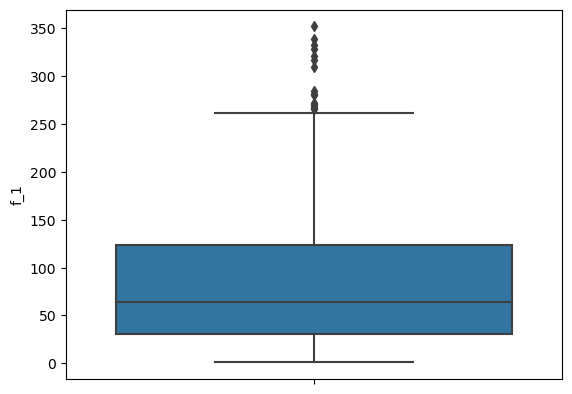

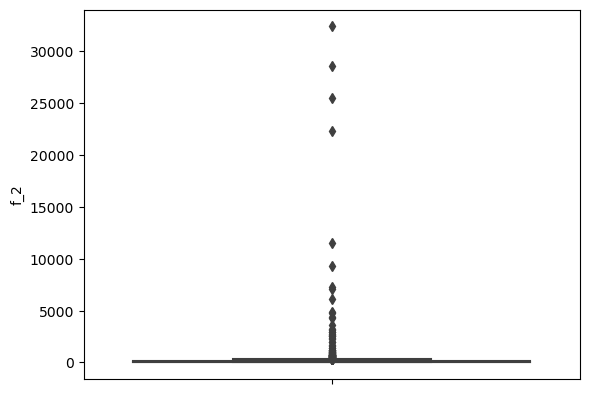

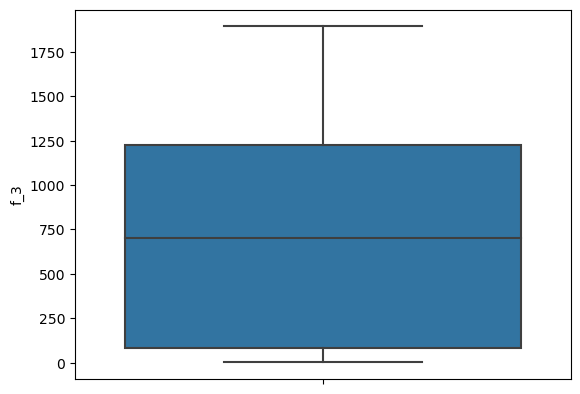

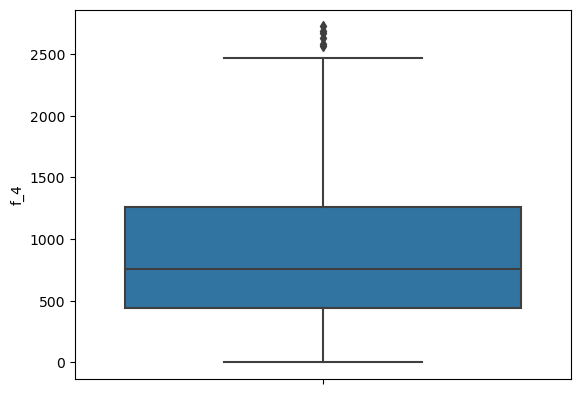

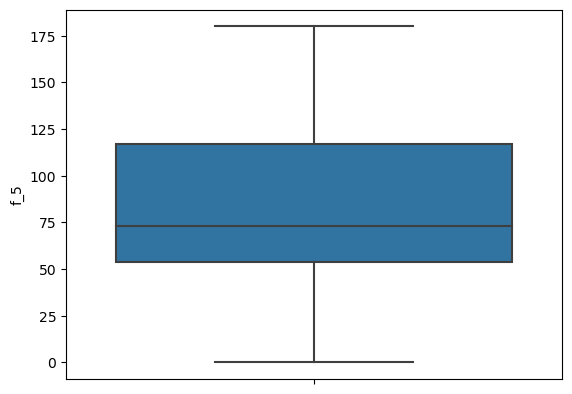

...

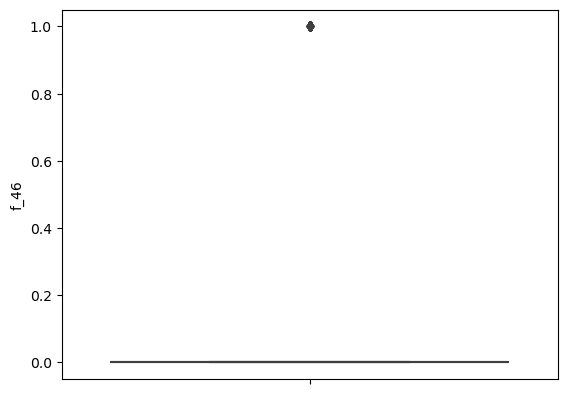

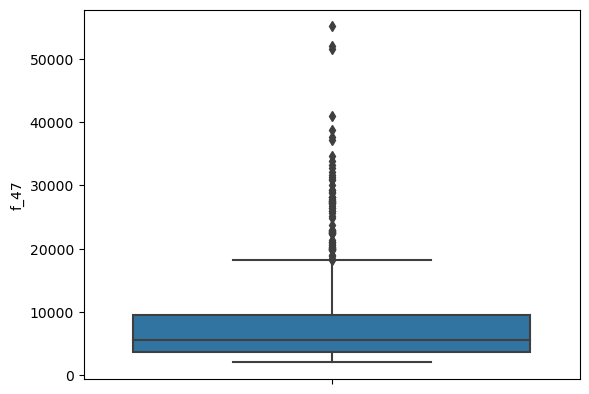

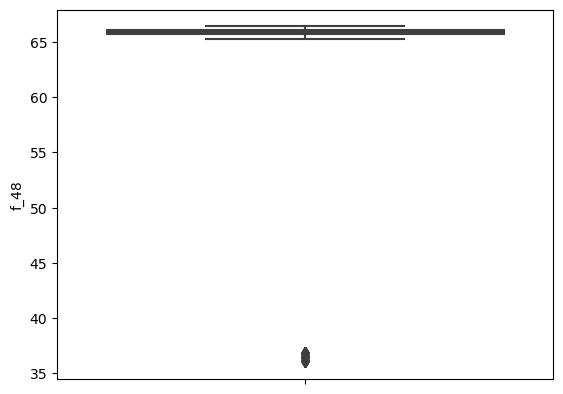

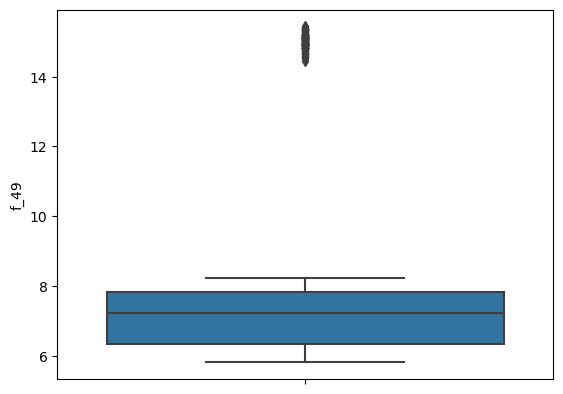

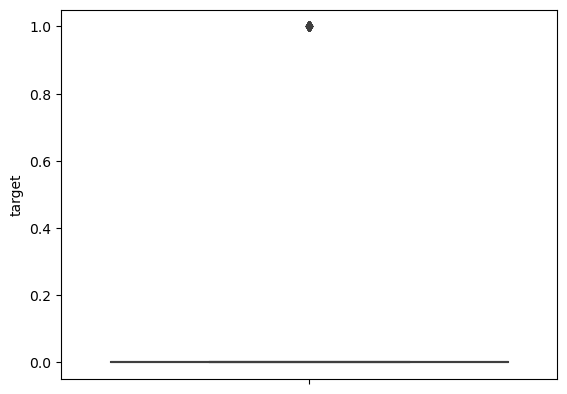

In [9]:
for column in data.columns:
    if data[column].dtype != "object":
        sns.boxplot(y = data[column])
        plt.show()
    

##### Multivariate Analysis

In [12]:
sns.pairplot(data=data)

##### Scaling

In [10]:
sc=StandardScaler()

In [11]:
x = data.iloc[:, :-1].values
y = data.iloc[:, -1].values

##### Cross Validation

In [12]:
models = {
    "LogisticRegression" : LogisticRegression(),
    "DecisionTreeClassifier" : DecisionTreeClassifier(),
    "RandomForestClassifier" : RandomForestClassifier(),
    "KNeighborsClassifier"   : KNeighborsClassifier(),
    "GradientBoostingClassifier":GradientBoostingClassifier()
}

In [13]:
for name, model in models.items():
    scores = cross_val_score(model, x,y, cv=20,n_jobs=-1)
    print("cross validation model : {}".format(name))
    average_score = np.mean(scores)*100
    print("AVERAGE SCORE: ",average_score)
    print("*"*100)

cross validation model : LogisticRegression
AVERAGE SCORE:  93.59389454209067
****************************************************************************************************
cross validation model : DecisionTreeClassifier
AVERAGE SCORE:  90.94588344125809
****************************************************************************************************
cross validation model : RandomForestClassifier
AVERAGE SCORE:  95.73080481036075
****************************************************************************************************
cross validation model : KNeighborsClassifier
AVERAGE SCORE:  95.41165587419054
****************************************************************************************************
cross validation model : GradientBoostingClassifier
AVERAGE SCORE:  95.83718778908417
****************************************************************************************************


##### Let's proceed with RandomForestClassifier

In [14]:
model = RandomForestClassifier()

In [15]:
x_train,x_test,y_train,y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [16]:
model.fit(x_train, y_train)
print("model trained with {}".format(model))
score_train =accuracy_score (y_train, model.predict(x_train))
score_tst = accuracy_score(y_test, model.predict(x_test))
con_train = confusion_matrix(y_train, model.predict(x_train))
con_test = confusion_matrix(y_test, model.predict(x_test))
print("Model accuracy on train is:: ",score_train)
print("Model accuracy on test is:: ", score_tst)
print("confusion_matrix train is:: ", con_train)
print("confusion_matrix test is:: ", con_test)
print("Wrong Predictions made:",(y_test !=model.predict(x_test)).sum(),'/',((y_test == model.predict(x_test)).sum()+(y_test != model.predict(x_test)).sum()))

model trained with RandomForestClassifier()
Model accuracy on train is::  1.0
Model accuracy on test is::  0.9787234042553191
confusion_matrix train is::  [[714   0]
 [  0  35]]
confusion_matrix test is::  [[181   1]
 [  3   3]]
Wrong Predictions made: 4 / 188


##### Confusion matrix for training and testing data

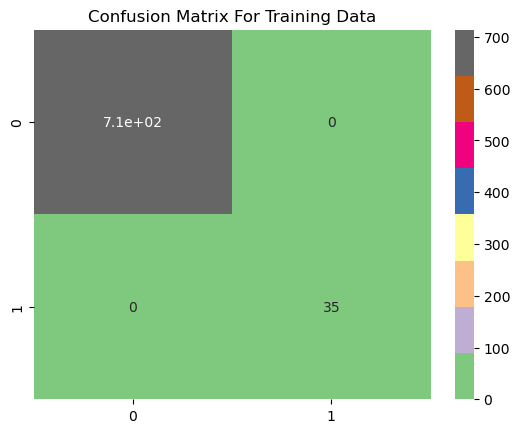

In [17]:
plt.title('Confusion Matrix For Training Data')
sns.heatmap(con_train, annot=True, cmap='Accent');

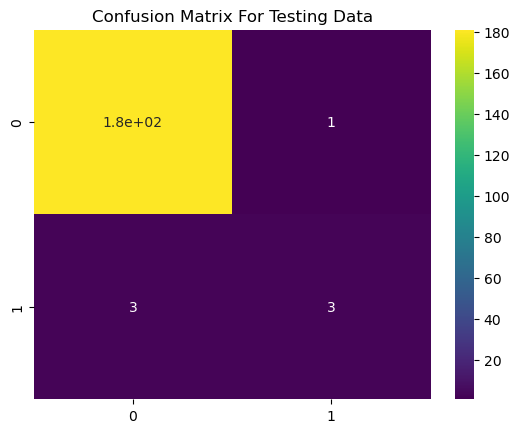

In [18]:
plt.title('Confusion Matrix For Testing Data')
sns.heatmap(con_test, annot=True, cmap='viridis');

##### ROC Curve

Model used is::  RandomForestClassifier()


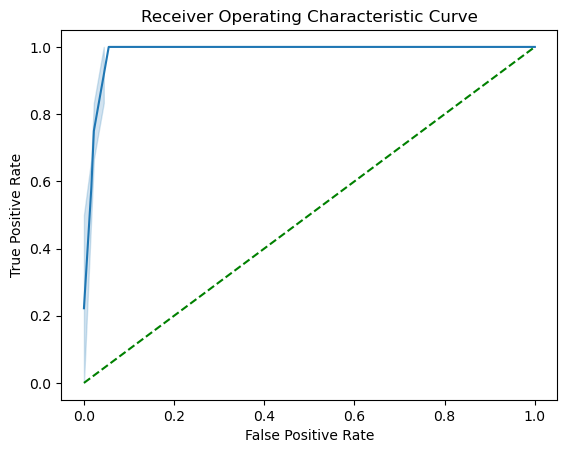

In [19]:
model.fit(x_train, y_train)
probs = model.predict_proba(x_test)
preds = probs[:,1]
fpr, tpr, threshold = metrics.roc_curve(y_test, preds)
roc_auc = metrics.auc(fpr, tpr)
print("Model used is:: ",model)
sns.lineplot(x= fpr, y=tpr)
plt.plot([0, 1], [0, 1], color='green', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic Curve')
plt.show()